In [117]:
import abc, math, os
from typing import List, Optional, Tuple, Union

import cv2
from PIL import Image
import torch
import numpy as np
from tqdm import tqdm
from diffusers import StableDiffusionPipeline, DDIMScheduler
from sklearn.decomposition import PCA
from torchvision import transforms as T

In [40]:
MODEL_ID = "runwayml/stable-diffusion-v1-5"
pipe = StableDiffusionPipeline.from_pretrained(MODEL_ID, torch_dtype=torch.float16)
pipe = pipe.to("cuda:3")

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


In [3]:
LOW_RESOURCE = False
NUM_DDIM_STEPS = 50
GUIDANCE_SCALE = 7.5

In [4]:
class AttentionControl(abc.ABC):

    def step_callback(self, x_t):
        return x_t
    
    def between_steps(self):
        return
    
    @property
    def num_uncond_att_layers(self):
        return self.num_att_layers if LOW_RESOURCE else 0
    
    @abc.abstractmethod
    def forward (self, attn, is_cross: bool, place_in_unet: str):
        raise NotImplementedError

    def __call__(self, attn, is_cross: bool, place_in_unet: str):
        if self.cur_att_layer >= self.num_uncond_att_layers:
            if LOW_RESOURCE:
                attn = self.forward(attn, is_cross, place_in_unet)
            else:
                h = attn.shape[0]
                attn[h // 2:] = self.forward(attn[h // 2:], is_cross, place_in_unet)
        self.cur_att_layer += 1
        if self.cur_att_layer == self.num_att_layers + self.num_uncond_att_layers:
            self.cur_att_layer = 0
            self.cur_step += 1
            self.between_steps()
        return attn
    
    def reset(self):
        self.cur_step = 0
        self.cur_att_layer = 0

    def __init__(self):
        self.cur_step = 0
        self.num_att_layers = -1
        self.cur_att_layer = 0


class AttentionStore(AttentionControl):

    @staticmethod
    def get_empty_store():
        return {"down_cross": [], "mid_cross": [], "up_cross": [],
                "down_self": [],  "mid_self": [],  "up_self": []}

    def forward(self, attn, is_cross: bool, place_in_unet: str):
        key = f"{place_in_unet}_{'cross' if is_cross else 'self'}"
        # if attn.shape[1] <= 32 ** 2:  # avoid memory overhead
        self.step_store[key].append(attn)
        return attn

    def between_steps(self):
        if len(self.attention_store) == 0:
            self.attention_store = self.step_store
        else:
            for key in self.attention_store:
                for i in range(len(self.attention_store[key])):
                    self.attention_store[key][i] += self.step_store[key][i]
        self.step_store = self.get_empty_store()

    def get_average_attention(self):
        # Averaged over timestep
        average_attention = {key: [item / self.cur_step for item in self.attention_store[key]] for key in self.attention_store}
        return average_attention

    def reset(self):
        super(AttentionStore, self).reset()
        self.step_store = self.get_empty_store()
        self.attention_store = {}

    def __init__(self):
        super(AttentionStore, self).__init__()
        self.step_store = self.get_empty_store()
        self.attention_store = {}
        
        
def register_attention_control(model, controller, do_cross: bool = True):
    def ca_forward(self, place_in_unet):
        to_out = self.to_out
        if type(to_out) is torch.nn.modules.container.ModuleList:
            to_out = self.to_out[0]
        else:
            to_out = self.to_out

        def forward(x, encoder_hidden_states=None,  attention_mask=None):
            batch_size, sequence_length, dim = x.shape
            h = self.heads
            q = self.to_q(x)
            is_cross = encoder_hidden_states is not None
            context = encoder_hidden_states if is_cross else x
            k = self.to_k(context)
            v = self.to_v(context)
            q = self.head_to_batch_dim(q)
            k = self.head_to_batch_dim(k)
            v = self.head_to_batch_dim(v)

            sim = torch.einsum("b i d, b j d -> b i j", q, k) * self.scale

            if attention_mask is not None:
                attention_mask = attention_mask.reshape(batch_size, -1)
                max_neg_value = -torch.finfo(sim.dtype).max
                attention_mask = attention_mask[:, None, :].repeat(h, 1, 1)
                sim.masked_fill_(~attention_mask, max_neg_value)

            # attention, what we cannot get enough of
            attn = sim.softmax(dim=-1)
#             print("new forward clas")
            attn = controller(attn, is_cross, place_in_unet)
            out = torch.einsum("b i j, b j d -> b i d", attn, v)
            out = self.batch_to_head_dim(out)
            return to_out(out)

        return forward

    class DummyController:

        def __call__(self, *args):
            return args[0]

        def __init__(self):
            self.num_att_layers = 0

    if controller is None:
        controller = DummyController()

    def register_recr(net_, count, place_in_unet):
        if hasattr(net_, 'to_k'):
            if do_cross and net_.to_k.weight.shape[1]==768:
                net_.forward = ca_forward(net_, place_in_unet)
            else:
                # self
                net_.forward = ca_forward(net_, place_in_unet)
            return count + 1
        elif hasattr(net_, 'children'):
            for net__ in net_.children():
                count = register_recr(net__, count, place_in_unet)
        return count

    cross_att_count = 0
    sub_nets = model.unet.named_children()
    for net in sub_nets:
        if "down" in net[0]:
            print("register", net[0])
            cross_att_count += register_recr(net[1], 0, "down")
        elif "up" in net[0]:
            cross_att_count += register_recr(net[1], 0, "up")
        elif "mid" in net[0]:
            cross_att_count += register_recr(net[1], 0, "mid")

    controller.num_att_layers = cross_att_count


# register control for each conv block


class ConvFeatureMapControl:

    def __call__(self, feature_map, place_in_unet: str):
        m = self.forward(feature_map, place_in_unet)
        self.cur_conv_layer += 1
        if self.cur_conv_layer == self.num_conv_layers:
            self.cur_step += 1
            self.cur_conv_layer = 0
            self.between_steps()
        return m

    def forward(self, feature_map, place_in_unet: str):
        key = f"{place_in_unet}_feature_map"
        if key not in self.step_store:
            self.step_store[key] = list()
        self.step_store[key].append(feature_map[1:])
        return feature_map

    def between_steps(self):
        if len(self.feature_map_store) == 0:
            self.feature_map_store = self.step_store
        else:
            for key in self.feature_map_store:
                self.feature_map_store[key].extend(self.step_store[key])
        self.step_store = dict()

    def get_average_feature_map(self):
        # Averaged over timestep
        # average_feature_map = {key: [item / self.cur_step for item in self.feature_map_store[key]] for key in self.feature_map_store}
        average_feature_map = dict()
        for key, values in self.feature_map_store.items():
            v = values[0]
            for i in values[1:]:
                v += i
            average_feature_map[key] = [v / self.cur_step]
        return average_feature_map
    
    def get_ts_feature_map(self, ts: int):
        feature_map = dict()
        for key, values in self.feature_map_store.items():
            feature_map[key] = [values[ts]]
        return feature_map

    def reset(self):
        self.step_store = dict()
        self.feature_map_store = dict()
        self.cur_step = 0
        self.cur_att_layer = 0
    
    def step_callback(self, x_t):
        return x_t

    def __init__(self):
        self.step_store = dict()
        self.feature_map_store = dict()

        self.cur_step = 0
        self.cur_conv_layer = 0
        self.num_conv_layers = 0


def register_conv_control(model, controller):

    def conv_forward(self, place_in_unet: str):
        def forward(input_tensor, temb):
            hidden_states = input_tensor

            hidden_states = self.norm1(hidden_states)
            hidden_states = self.nonlinearity(hidden_states)

            if self.upsample is not None:
                # upsample_nearest_nhwc fails with large batch sizes. see https://github.com/huggingface/diffusers/issues/984
                if hidden_states.shape[0] >= 64:
                    input_tensor = input_tensor.contiguous()
                    hidden_states = hidden_states.contiguous()
                input_tensor = self.upsample(input_tensor)
                hidden_states = self.upsample(hidden_states)
            elif self.downsample is not None:
                input_tensor = self.downsample(input_tensor)
                hidden_states = self.downsample(hidden_states)

            hidden_states = self.conv1(hidden_states)

            if temb is not None:
                temb = self.time_emb_proj(self.nonlinearity(temb))[:, :, None, None]

            if temb is not None and self.time_embedding_norm == "default":
                hidden_states = hidden_states + temb

            hidden_states = self.norm2(hidden_states)

            if temb is not None and self.time_embedding_norm == "scale_shift":
                scale, shift = torch.chunk(temb, 2, dim=1)
                hidden_states = hidden_states * (1 + scale) + shift

            hidden_states = self.nonlinearity(hidden_states)

            hidden_states = self.dropout(hidden_states)
            hidden_states = self.conv2(hidden_states)
            
            # control
            controller(hidden_states, place_in_unet)

            if self.conv_shortcut is not None:
                input_tensor = self.conv_shortcut(input_tensor)

            output_tensor = (input_tensor + hidden_states) / self.output_scale_factor

            return output_tensor

        return forward

    class DummyConvController:

        def __call__(self, *args):
            return args[0]

        def __init__(self):
            self.num_conv_layers = 0

    if controller is None:
        controller = DummyConvController()
    
    conv_count = 0
    up_res_dict = {0: [0, 1, 2], 1: [0, 1, 2], 2: [0, 1, 2], 3: [0, 1, 2]}
    for res in up_res_dict:
        for block in up_res_dict[res]:
            # up blocks
            up_module = model.unet.up_blocks[res].resnets[block]
            up_module.forward = conv_forward(up_module, f'up_block{res}_res{block}')
            conv_count += 1

    # down
    down_res_dict = {0: [0, 1], 1: [0, 1], 2: [0, 1], 3: [0, 1]}
    # down_res_dict = {}
    for res in down_res_dict:
        for block in down_res_dict[res]:
            down_module = model.unet.down_blocks[res].resnets[block]
            down_module.forward = conv_forward(down_module, f'down_block{res}_res{block}')
            conv_count += 1

    # mid
    for i in range(2):
        mid_module = model.unet.mid_block.resnets[i]
        mid_module.forward =  conv_forward(mid_module, f'mid_block0_res{i}')
        conv_count += 1

    controller.num_conv_layers = conv_count

In [29]:
def load_img(image_path: str, left: int = 0, right: int = 0, top: int = 0, bottom: int = 0) -> np.ndarray:
    if type(image_path) is str:
        image = np.array(Image.open(image_path))[:, :, :3]
    else:
        image = image_path
    h, w, c = image.shape
    left = min(left, w-1)
    right = min(right, w - left - 1)
    top = min(top, h - left - 1)
    bottom = min(bottom, h - top - 1)
    image = image[top:h-bottom, left:w-right]
    h, w, c = image.shape
    if h < w:
        offset = (w - h) // 2
        image = image[:, offset:offset + h]
    elif w < h:
        offset = (h - w) // 2
        image = image[offset:offset + w]
    image = np.array(Image.fromarray(image).resize((512, 512)))
    return image


def image2latent(vae, image) -> torch.Tensor:
    with torch.autocast(device_type='cuda', dtype=torch.float32):
        if type(image) is Image:
            image = np.array(image)
        if type(image) is torch.Tensor and image.dim() == 4:
            latents = image
        else:
            image = torch.from_numpy(image).float() / 127.5 - 1
            image = image.permute(2, 0, 1).unsqueeze(0).to(vae.device)
            latents = vae.encode(image)['latent_dist'].mean
            latents = latents * 0.18215
    return latents


@torch.no_grad()
def latent2image(vae, latents) -> np.ndarray:
    with torch.autocast(device_type='cuda', dtype=torch.float32):
        latents = 1 / 0.18215 * latents
        image = vae.decode(latents)['sample']
        image = (image / 2 + 0.5).clamp(0, 1)
        image = image.cpu().permute(0, 2, 3, 1).numpy()
        image = (image * 255).astype(np.uint8)
    return image


class DDIMAttentionStore(AttentionStore):
    
    def __call__(self, attn, is_cross: bool, place_in_unet: str):
        if self.cur_att_layer >= self.num_uncond_att_layers:
            if LOW_RESOURCE:
                attn = self.forward(attn, is_cross, place_in_unet)
            else:
                attn = self.forward(attn, is_cross, place_in_unet)
        self.cur_att_layer += 1
        if self.cur_att_layer == self.num_att_layers + self.num_uncond_att_layers:
            self.cur_att_layer = 0
            self.cur_step += 1
            self.between_steps()
        return attn


class DDIMInversion:
    
    @torch.no_grad()
    def init_prompt(self, model, prompt: str):
        uncond_input = model.tokenizer(
            [""], padding="max_length", max_length=model.tokenizer.model_max_length,
            return_tensors="pt"
        )
        uncond_embeddings = model.text_encoder(uncond_input.input_ids.to(model.device))[0]
        text_input = model.tokenizer(
            [prompt],
            padding="max_length",
            max_length=model.tokenizer.model_max_length,
            truncation=True,
            return_tensors="pt",
        )
        text_embeddings = model.text_encoder(text_input.input_ids.to(model.device))[0]
        return torch.cat([uncond_embeddings, text_embeddings])
    
    def get_noise_pred_single(self, model, latents, t, context):
        noise_pred = model.unet(latents, t, encoder_hidden_states=context)["sample"]
        return noise_pred
    
    def next_step(self, model, model_output: Union[torch.FloatTensor, np.ndarray], timestep: int, sample: Union[torch.FloatTensor, np.ndarray]):
        timestep, next_timestep = min(timestep - model.scheduler.config.num_train_timesteps // model.scheduler.num_inference_steps, 999), timestep
        alpha_prod_t = model.scheduler.alphas_cumprod[timestep] if timestep >= 0 else model.scheduler.final_alpha_cumprod
        alpha_prod_t_next = model.scheduler.alphas_cumprod[next_timestep]
        beta_prod_t = 1 - alpha_prod_t
        next_original_sample = (sample - beta_prod_t ** 0.5 * model_output) / alpha_prod_t ** 0.5
        next_sample_direction = (1 - alpha_prod_t_next) ** 0.5 * model_output
        next_sample = alpha_prod_t_next ** 0.5 * next_original_sample + next_sample_direction
        return next_sample
    
    @torch.no_grad()
    def ddim_loop(self, model, latent, text_embeds, num_inner_steps: int) -> List:
        with torch.autocast(device_type='cuda', dtype=torch.float32):
            model.scheduler.set_timesteps(num_inner_steps)
            uncond_embeddings, cond_embeddings = text_embeds.chunk(2)
            all_latent = [latent]
            latent = latent.clone().detach()
            for i in tqdm(range(num_inner_steps)):
                t = model.scheduler.timesteps[len(model.scheduler.timesteps) - i - 1]
                noise_pred = self.get_noise_pred_single(model, latent, t, cond_embeddings)
                latent = self.next_step(model, noise_pred, t, latent)
                all_latent.append(latent)
        return all_latent

    @torch.no_grad()
    def ddim_inversion(self, model, img: np.ndarray, text_embeds, num_inner_steps) -> Tuple[np.ndarray, List]:
        latent = image2latent(model.vae, img)
        image_rec = latent2image(model.vae, latent)
        ddim_latents = self.ddim_loop(model, latent, text_embeds, num_inner_steps)
        return image_rec, ddim_latents

    def invert(self, model, image_path: str, prompt: str, num_inner_steps: int = 50, offsets=(0,0,0,0)) -> Tuple[np.ndarray, List]:
        text_embeds = self.init_prompt(model, prompt)
        image_gt = load_img(image_path, *offsets)
        image_rec, ddim_latents = self.ddim_inversion(model, image_gt, text_embeds, num_inner_steps)
        return image_rec, ddim_latents

    def prev_step(self, model, model_output: Union[torch.FloatTensor, np.ndarray], timestep: int, sample: Union[torch.FloatTensor, np.ndarray]):
        prev_timestep = timestep - model.scheduler.config.num_train_timesteps // model.scheduler.num_inference_steps
        alpha_prod_t = model.scheduler.alphas_cumprod[timestep]
        alpha_prod_t_prev = model.scheduler.alphas_cumprod[prev_timestep] if prev_timestep >= 0 else model.scheduler.final_alpha_cumprod
        beta_prod_t = 1 - alpha_prod_t
        pred_original_sample = (sample - beta_prod_t ** 0.5 * model_output) / alpha_prod_t ** 0.5
        pred_sample_direction = (1 - alpha_prod_t_prev) ** 0.5 * model_output
        prev_sample = alpha_prod_t_prev ** 0.5 * pred_original_sample + pred_sample_direction
        return prev_sample
    
    @torch.no_grad()
    def ddim_sample(self, model, latent, text_embeds, num_inner_steps):
        with torch.autocast(device_type='cuda', dtype=torch.float32):
            model.scheduler.set_timesteps(num_inner_steps)
            timesteps = model.scheduler.timesteps
            uncond_embeddings, cond_embeddings = text_embeds.chunk(2)
            for i, t in enumerate(tqdm(timesteps)):
                noise_pred = self.get_noise_pred_single(model, latent, t, cond_embeddings)
                latent = self.prev_step(model, noise_pred, t, latent)
            return latent
    
    def reverse(self, model, latent, prompt: str, num_inner_steps: int = 50, controller: DDIMAttentionStore = None) -> Tuple[np.ndarray, List]:
        text_embeds = self.init_prompt(model, prompt)
        register_attention_control(model, controller, do_cross=True)
        reversed_x0 = self.ddim_sample(model, latent, text_embeds, num_inner_steps)
        reversed_img = latent2image(model.vae, reversed_x0.detach())
        return reversed_img

In [48]:
def init_latent(latent, model, height, width, generator, batch_size):
    if latent is None:
        latent = torch.randn(
            (1, model.unet.in_channels, height // 8, width // 8),
            generator=generator,
        )
    latents = latent.expand(batch_size,  model.unet.in_channels, height // 8, width // 8).to(model.device)
    return latent, latents


def diffusion_step(model, controller, latents, context, t, guidance_scale, low_resource=False, conv_controller = None, scheduler = None):
    if low_resource:
        noise_pred_uncond = model.unet(latents, t, encoder_hidden_states=context[0])["sample"]
        noise_prediction_text = model.unet(latents, t, encoder_hidden_states=context[1])["sample"]
    else:
        latents_input = torch.cat([latents] * 2)
        noise_pred = model.unet(latents_input, t, encoder_hidden_states=context)["sample"]
        noise_pred_uncond, noise_prediction_text = noise_pred.chunk(2)
    noise_pred = noise_pred_uncond + guidance_scale * (noise_prediction_text - noise_pred_uncond)
    if scheduler is None:
        latents = model.scheduler.step(noise_pred, t, latents)["prev_sample"]
    else:
        latents = scheduler.step(noise_pred, t, latents)["prev_sample"]
    if controller is not None:
        latents = controller.step_callback(latents)
    if conv_controller is not None:
        latents = conv_controller.step_callback(latents)
    return latents


@torch.no_grad()
def text2image_ldm_stable(
    model,
    prompt:  List[str],
    controller,
    conv_controller = None,
    num_inference_steps: int = 50,
    guidance_scale: Optional[float] = 7.5,
    generator: Optional[torch.Generator] = None,
    latent: Optional[torch.FloatTensor] = None,
    uncond_embeddings=None,
    start_time=50,
    return_type='image',
    do_cross: bool = True,
    use_ddim: bool = False
):
    batch_size = len(prompt)
    register_attention_control(model, controller, do_cross=do_cross)
    register_conv_control(model, conv_controller)
    height = width = 512
    
    text_input = model.tokenizer(
        prompt,
        padding="max_length",
        max_length=model.tokenizer.model_max_length,
        truncation=True,
        return_tensors="pt",
    )
    text_embeddings = model.text_encoder(text_input.input_ids.to(model.device))[0]
    max_length = text_input.input_ids.shape[-1]
    if uncond_embeddings is None:
        uncond_input = model.tokenizer(
            [""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt"
        )
        uncond_embeddings_ = model.text_encoder(uncond_input.input_ids.to(model.device))[0]
    else:
        uncond_embeddings_ = None

    latent, latents = init_latent(latent, model, height, width, generator, batch_size)
    latent = latent.to(dtype=text_embeddings.dtype)
    latents = latents.to(dtype=text_embeddings.dtype)
    if use_ddim:
        custom_scheduler = DDIMScheduler.from_pretrained(MODEL_ID, subfolder="scheduler")
        custom_scheduler.set_timesteps(num_inference_steps)
    else:
        custom_scheduler = None
        model.scheduler.set_timesteps(num_inference_steps)
    for i, t in enumerate(tqdm(model.scheduler.timesteps[-start_time:])):
        if uncond_embeddings_ is None:
            context = torch.cat([uncond_embeddings[i].expand(*text_embeddings.shape), text_embeddings])
        else:
            context = torch.cat([uncond_embeddings_, text_embeddings])
        latents = diffusion_step(model, controller, latents, context, t, guidance_scale, low_resource=False, conv_controller=conv_controller, scheduler=custom_scheduler)
        
    if return_type == 'image':
        image = latent2image(model.vae, latents)
    else:
        image = latents
    return image, latent


def view_images(images, num_rows=1, offset_ratio=0.02):
    if type(images) is list:
        num_empty = len(images) % num_rows
    elif images.ndim == 4:
        num_empty = images.shape[0] % num_rows
    else:
        images = [images]
        num_empty = 0

    empty_images = np.ones(images[0].shape, dtype=np.uint8) * 255
    images = [image.astype(np.uint8) for image in images] + [empty_images] * num_empty
    num_items = len(images)

    h, w, c = images[0].shape
    offset = int(h * offset_ratio)
    num_cols = num_items // num_rows
    image_ = np.ones((h * num_rows + offset * (num_rows - 1),
                      w * num_cols + offset * (num_cols - 1), 3), dtype=np.uint8) * 255
    for i in range(num_rows):
        for j in range(num_cols):
            image_[i * (h + offset): i * (h + offset) + h:, j * (w + offset): j * (w + offset) + w] = images[
                i * num_cols + j]

    pil_img = Image.fromarray(image_)
    display(pil_img)


def text_under_image(image: np.ndarray, text: str, text_color: Tuple[int, int, int] = (0, 0, 0)):
    h, w, c = image.shape
    offset = int(h * .2)
    img = np.ones((h + offset, w, c), dtype=np.uint8) * 255
    font = cv2.FONT_HERSHEY_SIMPLEX
    # font = ImageFont.truetype("/usr/share/fonts/truetype/noto/NotoMono-Regular.ttf", font_size)
    img[:h] = image
    textsize = cv2.getTextSize(text, font, 1, 2)[0]
    text_x, text_y = (w - textsize[0]) // 2, h + offset - textsize[1] // 2
    cv2.putText(img, text, (text_x, text_y ), font, 1, text_color, 2)
    return img


def aggregate_attention(attention_store: AttentionStore, res: int, from_where: List[str], is_cross: bool, select: int):
    out = []
    attention_maps = attention_store.get_average_attention()
    num_pixels = res ** 2
    for location in from_where:
        for item in attention_maps[f"{location}_{'cross' if is_cross else 'self'}"]:
            if item.shape[1] == num_pixels:
                cross_maps = item.reshape(1, -1, res, res, item.shape[-1])[0]
                out.append(cross_maps)
    out = torch.cat(out, dim=0)
    out = out.sum(0) / out.shape[0] # Average over num_heads
    return out.cpu()


def show_cross_attention(prompt: str, tokenizer, attention_store: AttentionStore, res: int, from_where: List[str], select: int = 0, num_words: int =-1):
    tokens = tokenizer.encode(prompt)
    decoder = tokenizer.decode
    attention_maps = aggregate_attention(attention_store, res, from_where, True, select)
    images = []
    num_words = len(tokens) if num_words == -1 else max(num_words, len(tokens))
    for i in range(num_words):
        image = attention_maps[:, :, i]
        image = 255 * image / image.max()
        image = image.unsqueeze(-1).expand(*image.shape, 3)
        image = image.numpy().astype(np.uint8)
        image = np.array(Image.fromarray(image).resize((256, 256)))
        if i >= len(tokens):
            image = text_under_image(image, "[pad]")
        else:
            image = text_under_image(image, decoder(int(tokens[i])))
        images.append(image)
    view_images(np.stack(images, axis=0))


def show_self_attention_comp(attention_store: AttentionStore, res: int, from_where: List[str],
                        max_com=10, select: int = 0):
    attention_maps = aggregate_attention(attention_store, res, from_where, False, select).numpy().reshape((res ** 2, res ** 2))
    attention_maps = attention_maps.astype('float32')
    u, s, vh = np.linalg.svd(attention_maps - np.mean(attention_maps, axis=1, keepdims=True)) # Singular Value Decomposition
    images = []
    for i in range(max_com):
        image = vh[i].reshape(res, res)
        image = image - image.min()
        image = 255 * image / image.max()
        image = np.repeat(np.expand_dims(image, axis=2), 3, axis=2).astype(np.uint8)
        image = Image.fromarray(image).resize((256, 256))
        image = np.array(image)
        images.append(image)
    view_images(np.concatenate(images, axis=1))


def show_conv_feature_map(feature_map, max_com=3):
    bsz, nc, h, w = feature_map.size()
    feature_maps_fit_data = feature_map.reshape(bsz, nc, h*w).permute(0, 2, 1).reshape(bsz * h * w, nc).cpu().numpy()
    pca = PCA(n_components=max_com)
    pca.fit(feature_maps_fit_data)
    feature_maps_pca = pca.transform(feature_maps_fit_data)
    feature_maps_pca = feature_maps_pca.reshape(1, -1, max_com)

    pca_img = feature_maps_pca[0]
    h = w = int(math.sqrt(pca_img.shape[0]))
    pca_img = pca_img.reshape(h, w, 3)
    pca_img_min = pca_img.min(axis=(0, 1))
    pca_img_max = pca_img.max(axis=(0, 1))
    pca_img = (pca_img - pca_img_min) / (pca_img_max - pca_img_min)
    pca_img = Image.fromarray((pca_img * 255).astype(np.uint8))
    pca_img = T.Resize(h * 4, interpolation=T.InterpolationMode.NEAREST)(pca_img)
    display(pca_img)

In [7]:
def evaluate(prompt: str):
    prompts = [prompt]
    controller = AttentionStore()
    images, x_t = text2image_ldm_stable(
        pipe, prompts, controller,
        latent=None, num_inference_steps=NUM_DDIM_STEPS, 
        guidance_scale=GUIDANCE_SCALE, generator=None, 
        uncond_embeddings=None,
        do_cross=True
    )
    view_images(images)
    # dict_keys(['down_cross', 'mid_cross', 'up_cross', 'down_self', 'mid_self', 'up_self'])
    print("down_cross: 64 X 64")
    show_cross_attention(prompt, pipe.tokenizer, controller, 64, ["down"])
    print("down_cross: 32 X 32")
    show_cross_attention(prompt, pipe.tokenizer, controller, 32, ["down"])
    print("down_cross: 16 X 16")
    show_cross_attention(prompt, pipe.tokenizer, controller, 16, ["down"])
    print("mid_cross: 8 X 8")
    show_cross_attention(prompt, pipe.tokenizer, controller, 8, ["mid"])
    print("up_cross: 16 X 16")
    show_cross_attention(prompt, pipe.tokenizer, controller, 16, ["up"])
    print("up_cross: 32 X 32")
    show_cross_attention(prompt, pipe.tokenizer, controller, 32, ["up"])
    print("up_cross: 64 X 64")
    show_cross_attention(prompt, pipe.tokenizer, controller, 64, ["up"])


def evaluate_self_attn(prompt: str):
    prompts = [prompt]
    controller = AttentionStore()
    images, x_t = text2image_ldm_stable(
        pipe, prompts, controller,
        latent=None, num_inference_steps=NUM_DDIM_STEPS, 
        guidance_scale=GUIDANCE_SCALE, generator=None, 
        uncond_embeddings=None,
        do_cross=False
    )
    view_images(images)
    print("down_self: 64 X 64")
    show_self_attention_comp(controller, 64, ['down'])
    print("down_self: 32 X 32")
    show_self_attention_comp(controller, 32, ['down'])
    print("down_self: 16 X 16")
    show_self_attention_comp(controller, 16, ['down'])
    print("mid_self: 8 X 8")
    show_self_attention_comp(controller, 8, ['mid'])
    print("up_self: 16 X 16")
    show_self_attention_comp(controller, 16, ['up'])
    print("up_self: 32 X 32")
    show_self_attention_comp(controller, 32, ['up'])
    print("up_self: 64 X 64")
    show_self_attention_comp(controller, 64, ['up'])

    
def evaluate_conv(prompt: str, steps = -1, vis_key: str = None):
    prompts = [prompt]
    controller = None
    conv_controller = ConvFeatureMapControl()
    images, x_t = text2image_ldm_stable(
        pipe, prompts, controller, conv_controller=conv_controller,
        latent=None, num_inference_steps=NUM_DDIM_STEPS, 
        guidance_scale=GUIDANCE_SCALE, generator=None, 
        uncond_embeddings=None,
        do_cross=False
    )
    view_images(images)
    if isinstance(steps, int):
        steps = [steps]
    for step in steps:
        print(f"Step: {step}")
        if step >= 0:
            averaged_feature_map_store = conv_controller.get_ts_feature_map(step)
        else:
            averaged_feature_map_store = conv_controller.get_average_feature_map()
        if vis_key is None:
            vis_key = ['down_block0_res1', 'down_block1_res1', 'down_block2_res1', 'down_block3_res1',  'mid_block0_res0', 'up_block0_res2', 'up_block1_res2', 'up_block2_res2', 'up_block3_res2']
        elif isinstance(vis_key, str):
            vis_key = [vis_key]
        for key in vis_key:
            show_conv_feature_map(averaged_feature_map_store[f"{key}_feature_map"][0])

In [140]:
def evaluate_inversion(img_path: str, prompt: str, test_prompt: str = None):
    controller = DDIMAttentionStore()
    inverse_fn = DDIMInversion()
    img_rec, all_latents = inverse_fn.invert(pipe, img_path, prompt=prompt, num_inner_steps=50)
    view_images(img_rec)
    x_T = all_latents[-1]
    if test_prompt is None:
        test_prompt = prompt
    print(x_T.size())
    print("Test prompt: ", test_prompt)
    img_reversed = inverse_fn.reverse(pipe, x_T, prompt=test_prompt, controller=controller, num_inner_steps=49)
    view_images(img_reversed)
        
    # visualize cross attention map
    num_words = 10
    print("down_cross: 64 X 64")
    show_cross_attention(test_prompt, pipe.tokenizer, controller, 64, ["down"], num_words=num_words)
    print("down_cross: 32 X 32")
    show_cross_attention(test_prompt, pipe.tokenizer, controller, 32, ["down"], num_words=num_words)
    print("down_cross: 16 X 16")
    show_cross_attention(test_prompt, pipe.tokenizer, controller, 16, ["down"], num_words=num_words)
    print("mid_cross: 8 X 8")
    show_cross_attention(test_prompt, pipe.tokenizer, controller, 8, ["mid"], num_words=num_words)
    print("up_cross: 16 X 16")
    show_cross_attention(test_prompt, pipe.tokenizer, controller, 16, ["up"], num_words=num_words)
    print("up_cross: 32 X 32")
    show_cross_attention(test_prompt, pipe.tokenizer, controller, 32, ["up"], num_words=num_words)
    print("up_cross: 64 X 64")
    show_cross_attention(test_prompt, pipe.tokenizer, controller, 64, ["up"], num_words=num_words)

    
def evaluate_inversion_with_cfg(img_paths: Union[str, List[str]], prompt: str, test_prompt: str = None, cfg: float = GUIDANCE_SCALE):
    inverse_fn = DDIMInversion()
    if isinstance(img_paths, str):
        img_paths = [img_paths]
    
    x_Ts = list()
    for idx, ip in enumerate(img_paths):
        img_rec, all_latents = inverse_fn.invert(pipe, ip, prompt=prompt, num_inner_steps=50)
        view_images(img_rec)
        x_Ts.append(all_latents[-1])
    x_T = (x_Ts[0] + x_Ts[1]) / 2.0
    x_T /= torch.norm(x_T)
    if test_prompt is None:
        test_prompt = prompt
    print(x_T.size())
    print("Test prompt: ", test_prompt)
    images, _ = text2image_ldm_stable(
        pipe, [test_prompt], controller=None, conv_controller=None,
        latent=x_T, num_inference_steps=50, 
        guidance_scale=cfg, generator=None, 
        uncond_embeddings=None,
        do_cross=True,
        use_ddim=True
    )
    view_images(images)


# For interpolation
def slerp(z1, z2, alpha):
    theta = torch.acos(torch.sum(z1 * z2) / (torch.norm(z1) * torch.norm(z2)))
    return (
        torch.sin((1 - alpha) * theta) / torch.sin(theta) * z1
        + torch.sin(alpha * theta) / torch.sin(theta) * z2
    )


def interpolate(img_path: str, prompt_1: str, prompt_2: str, test_prompt: str, cfg: float = 1.0):
    inverse_fn = DDIMInversion()
    img_rec, all_latents = inverse_fn.invert(pipe, img_path, prompt=prompt_1, num_inner_steps=50)
    view_images(img_rec)
    x_T1 = all_latents[-1]
    
    img_rec_2, all_latents_2 = inverse_fn.invert(pipe, img_path, prompt=prompt_2, num_inner_steps=50)
    view_images(img_rec_2)
    x_T2 = all_latents_2[-1]
    
    alpha = torch.arange(0.0, 1.01, 0.1).to(x_T1.device)
    for i in range(alpha.size(0)):
        print(i, alpha[i])
        _z = slerp(x_T1, x_T2, alpha[i])
        zimages, _ = text2image_ldm_stable(
            pipe, [test_prompt], controller=None, conv_controller=None,
            latent=_z, num_inference_steps=50, 
            guidance_scale=cfg, generator=None, 
            uncond_embeddings=None,
            do_cross=True,
            use_ddim=True
        )
        view_images(zimages)


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:04<00:00, 10.03it/s]


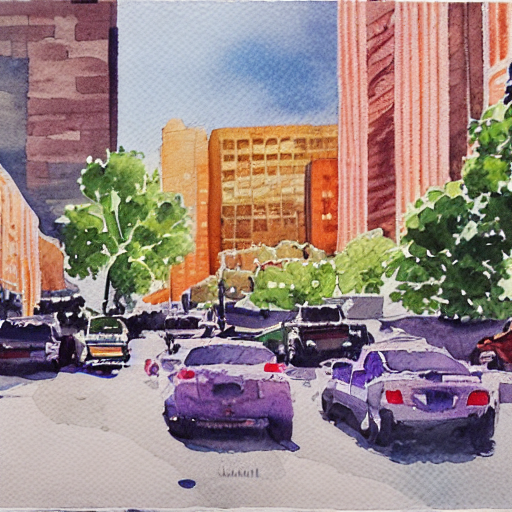

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:04<00:00, 10.00it/s]


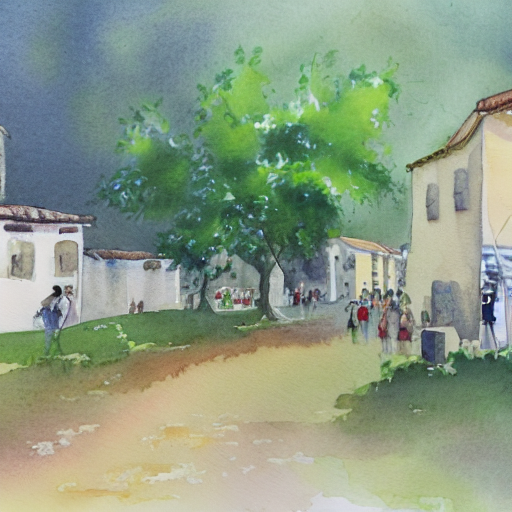

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:05<00:00,  9.99it/s]


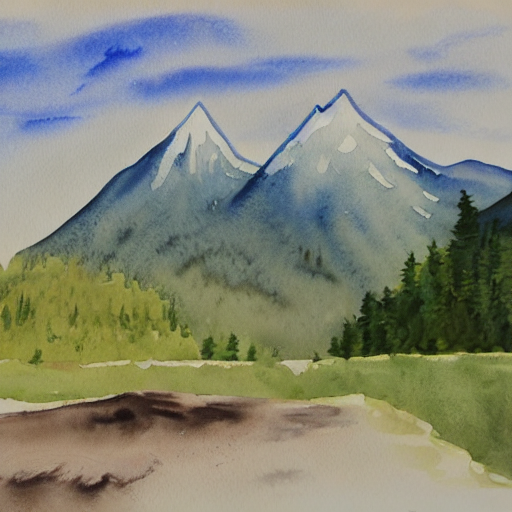

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:05<00:00,  9.98it/s]


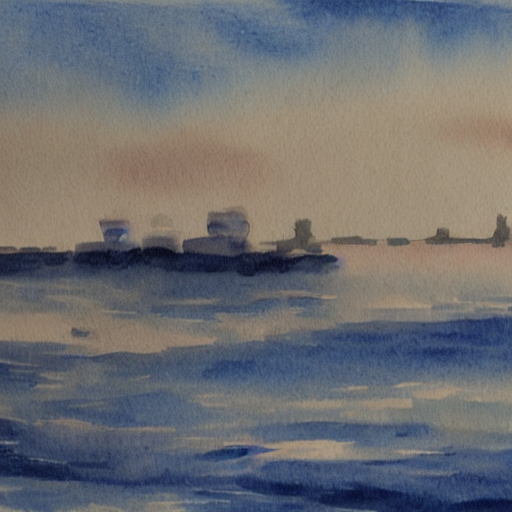

/tmp/ipykernel_1892412/3696731655.py:7: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = latent.expand(batch_size,  model.unet.in_channels, height // 8, width // 8).to(model.device)


torch.Size([1, 4, 64, 64])
Test prompt:  a painting of village
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.34it/s]


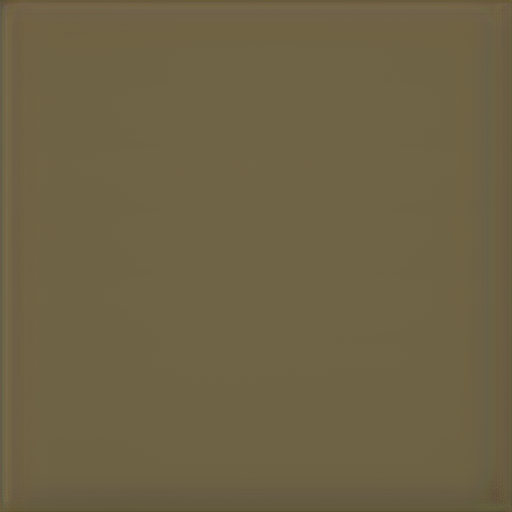

In [142]:
evaluate_inversion_with_cfg(
    [os.path.join('/home/jiaqiguo/pnp-diffusers/data/', name) for name in ['watercolor_1.png', 'watercolor_2.png', 'watercolor_3.png', 'watercolor_4.png']], 
    "watercolor painting",
    test_prompt="a painting of village",
    cfg=7.5
)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:05<00:00,  8.91it/s]


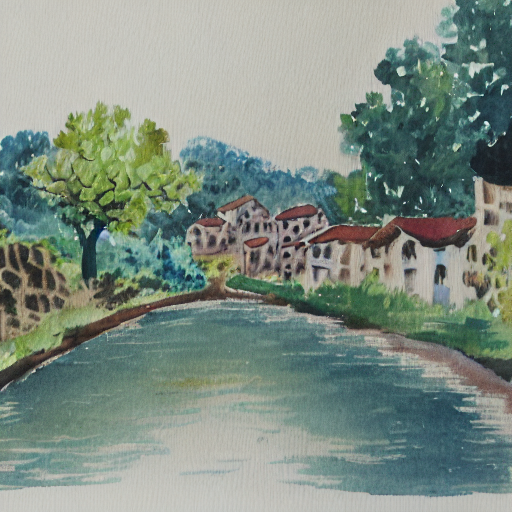

torch.Size([1, 4, 64, 64])
Test prompt:  downtown, custom style
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:05<00:00,  8.92it/s]


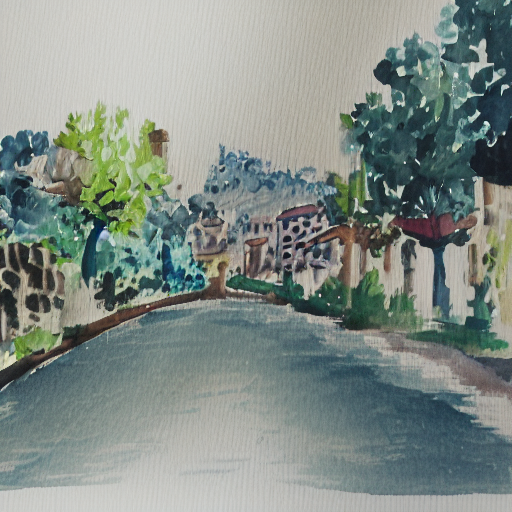

down_cross: 64 X 64


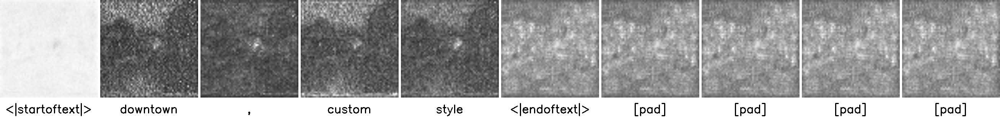

down_cross: 32 X 32


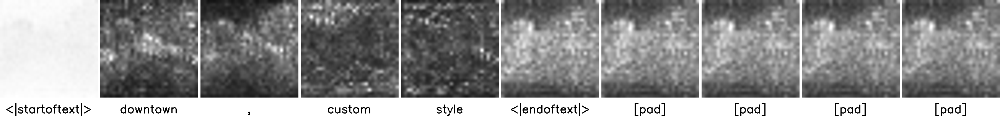

down_cross: 16 X 16


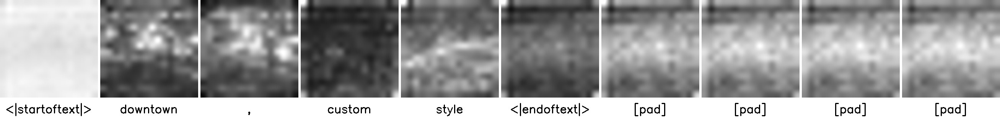

mid_cross: 8 X 8


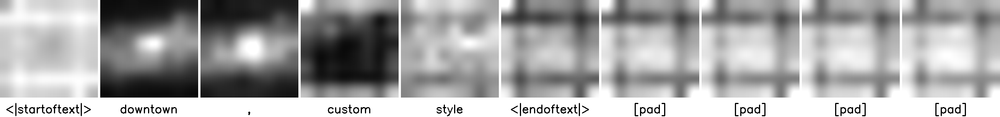

up_cross: 16 X 16


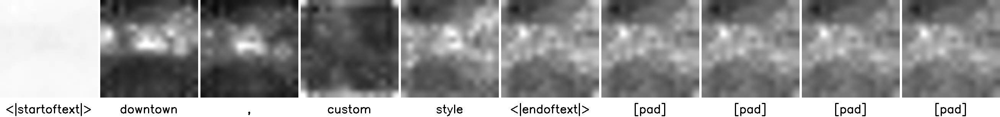

up_cross: 32 X 32


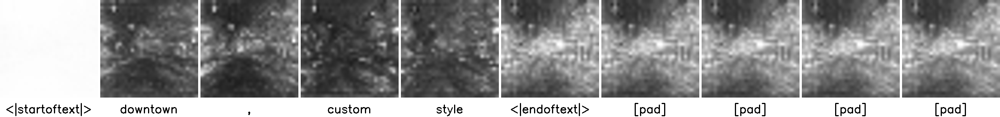

up_cross: 64 X 64


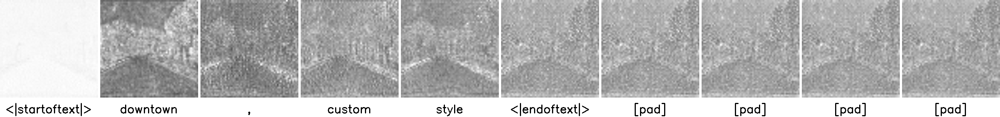

In [65]:
evaluate_inversion('/home/jiaqiguo/pnp-diffusers/data/test_image_2.png', "village, custom style", "downtown, custom style")

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:04<00:00, 10.19it/s]


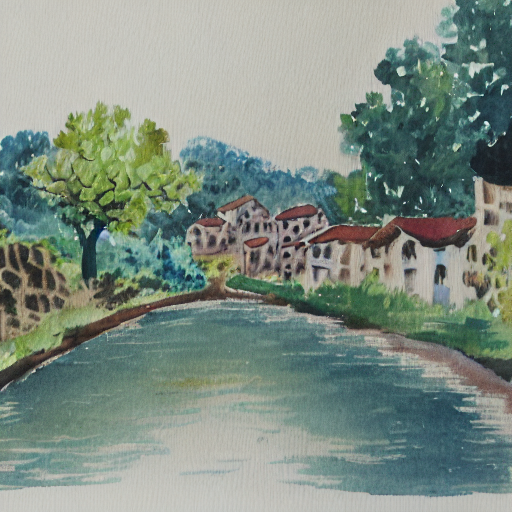

/tmp/ipykernel_1892412/3696731655.py:7: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = latent.expand(batch_size,  model.unet.in_channels, height // 8, width // 8).to(model.device)


torch.Size([1, 4, 64, 64])
Test prompt:  village, watercolor style
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.55it/s]


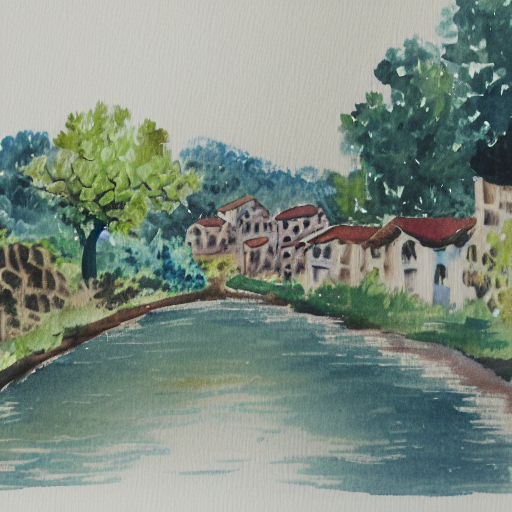

In [85]:
evaluate_inversion_with_cfg('/home/jiaqiguo/pnp-diffusers/data/test_image_2.png', "village, watercolor style", "village, watercolor style", cfg=1.0)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:04<00:00, 10.15it/s]


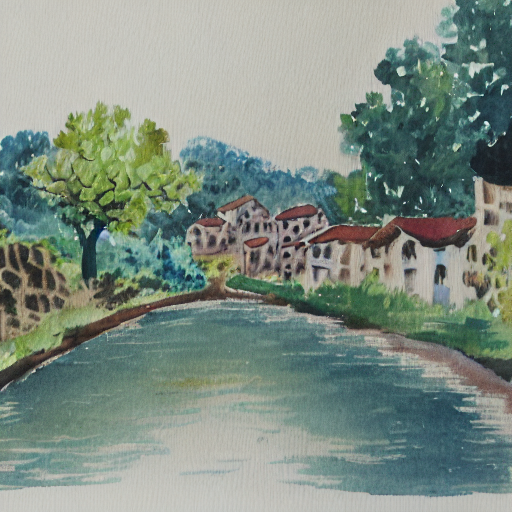

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:04<00:00, 10.11it/s]


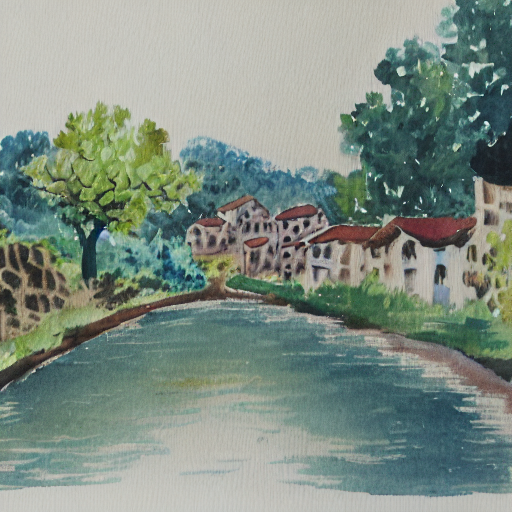

/tmp/ipykernel_1892412/3696731655.py:7: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = latent.expand(batch_size,  model.unet.in_channels, height // 8, width // 8).to(model.device)


0 tensor(0., device='cuda:3')
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.46it/s]


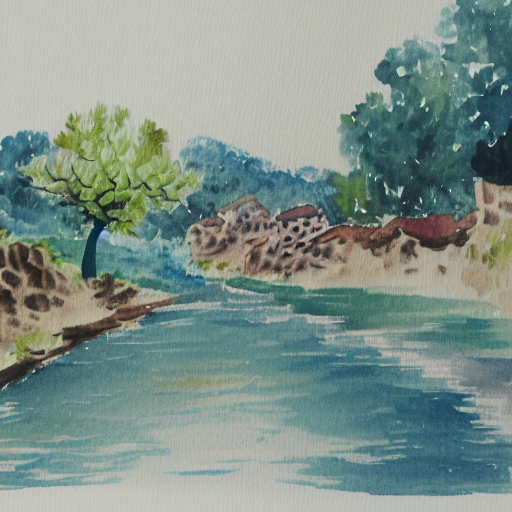

1 tensor(0.1000, device='cuda:3')
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.48it/s]


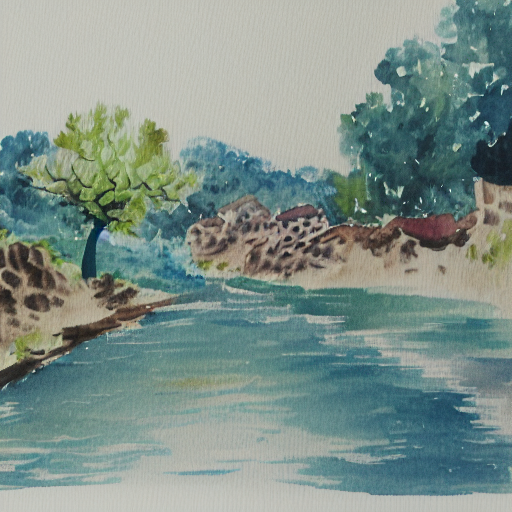

2 tensor(0.2000, device='cuda:3')
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.45it/s]


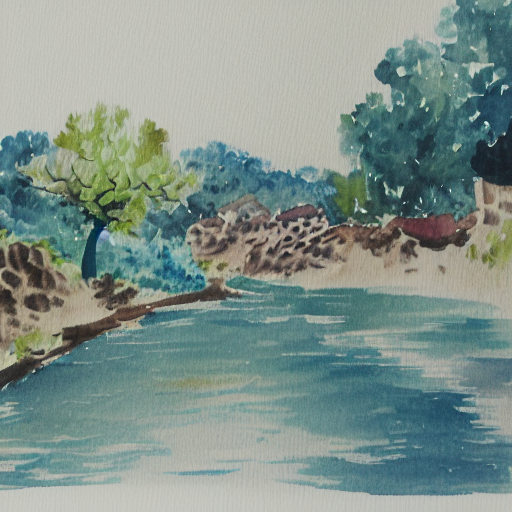

3 tensor(0.3000, device='cuda:3')
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.43it/s]


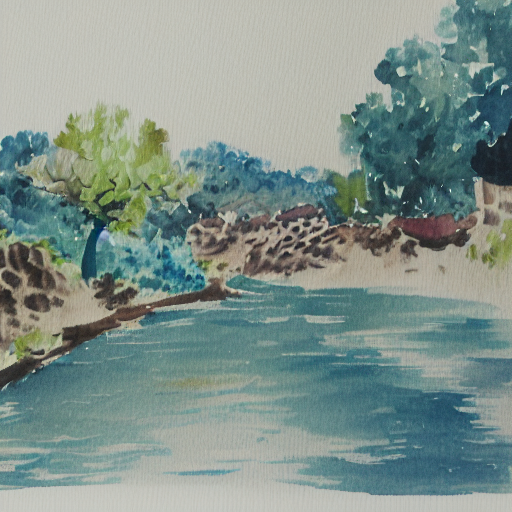

4 tensor(0.4000, device='cuda:3')
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.41it/s]


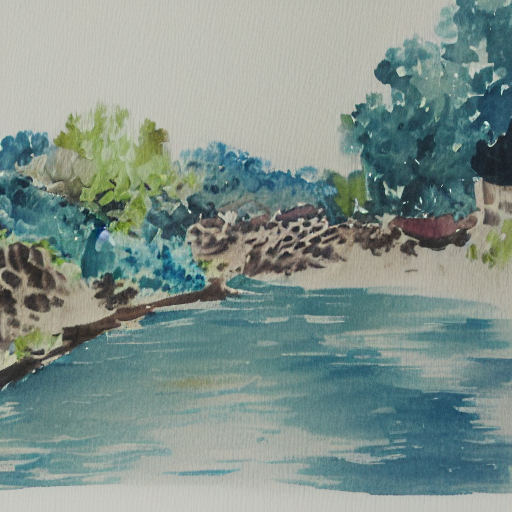

5 tensor(0.5000, device='cuda:3')
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.40it/s]


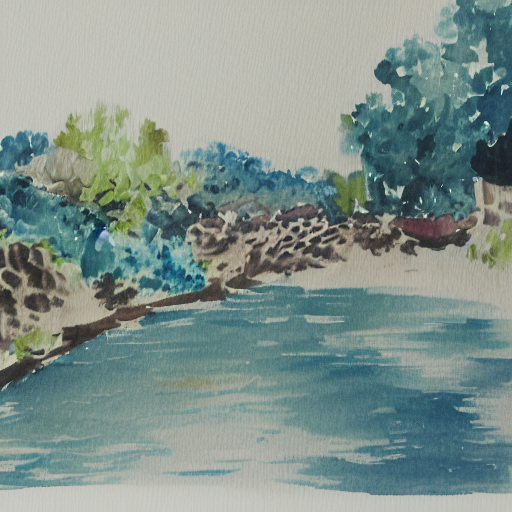

6 tensor(0.6000, device='cuda:3')
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.37it/s]


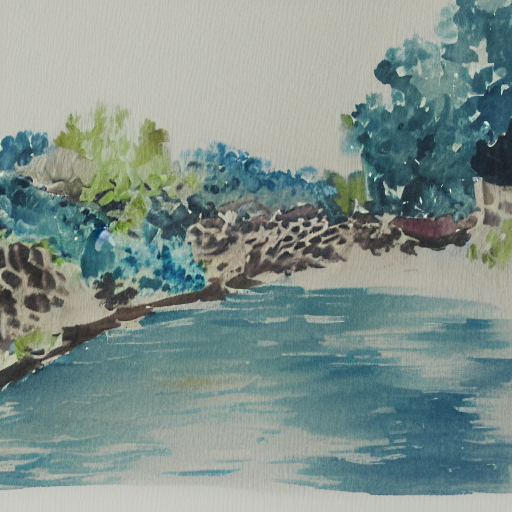

7 tensor(0.7000, device='cuda:3')
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.35it/s]


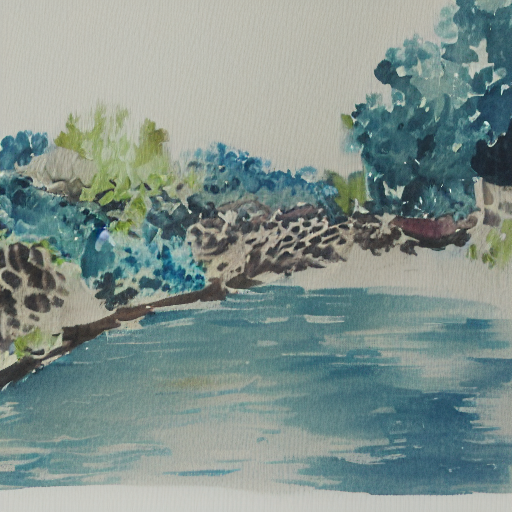

8 tensor(0.8000, device='cuda:3')
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.35it/s]


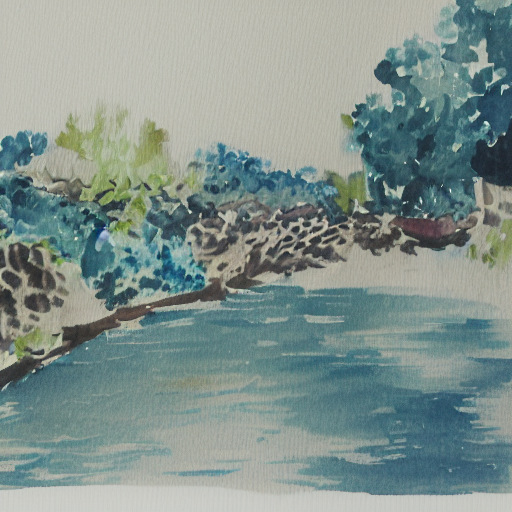

9 tensor(0.9000, device='cuda:3')
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.33it/s]


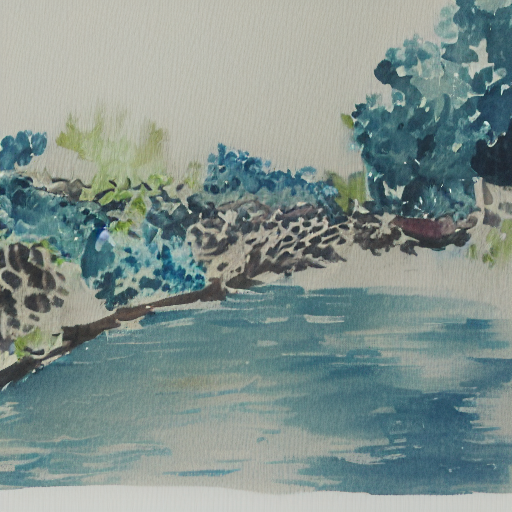

10 tensor(1., device='cuda:3')
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.33it/s]


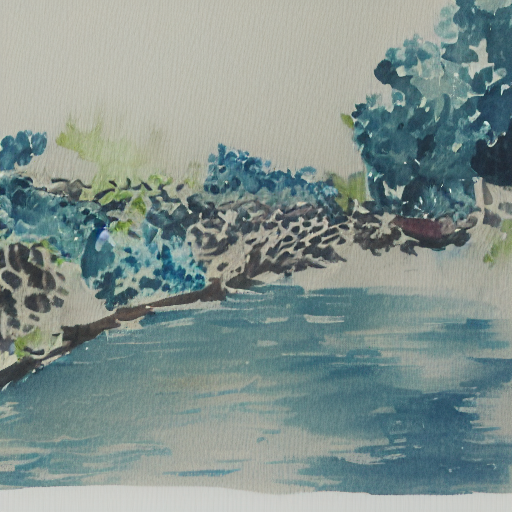

In [95]:
interpolate('/home/jiaqiguo/pnp-diffusers/data/test_image_2.png', prompt_1="", prompt_2="a beautiful village with a river", test_prompt="sea")

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:04<00:00, 10.18it/s]


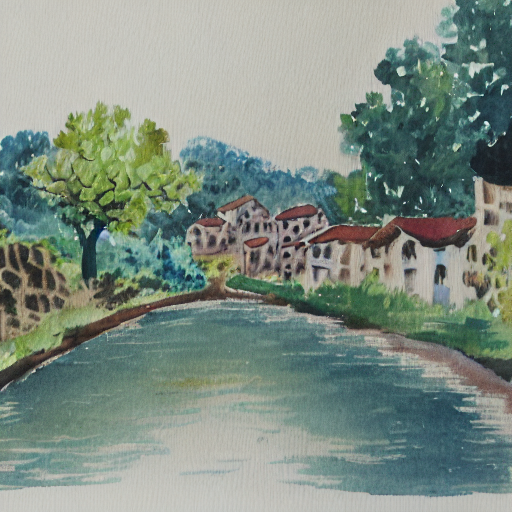

/tmp/ipykernel_1892412/3696731655.py:7: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = latent.expand(batch_size,  model.unet.in_channels, height // 8, width // 8).to(model.device)


torch.Size([1, 4, 64, 64])
Test prompt:  a cat sitting in the forest
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 14.53it/s]


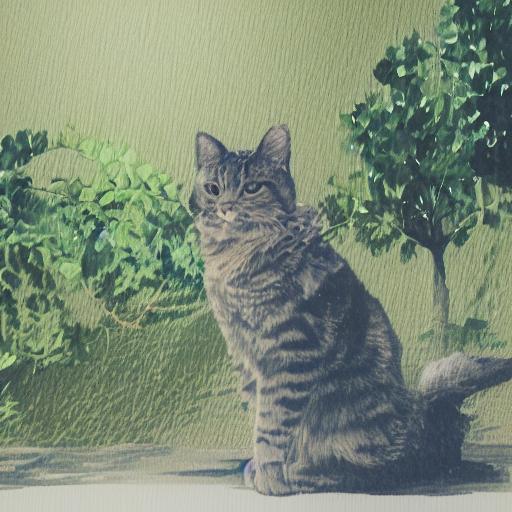

In [114]:
evaluate_inversion_with_cfg('/home/jiaqiguo/pnp-diffusers/data/test_image_2.png', "a beautiful village with a river", "a cat sitting in the forest", cfg=2.0)

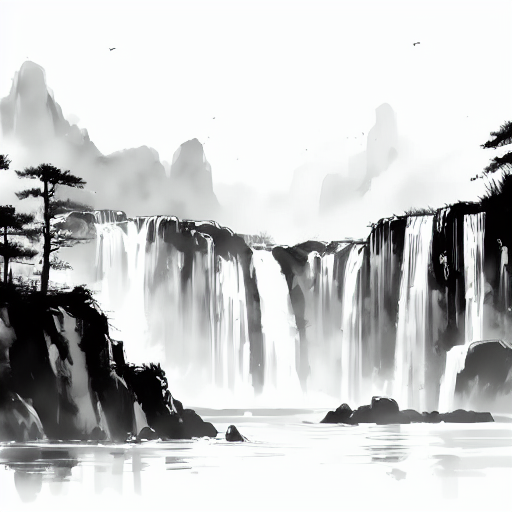

Test prompt:  mountain, Chinese style
register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:05<00:00,  8.95it/s]


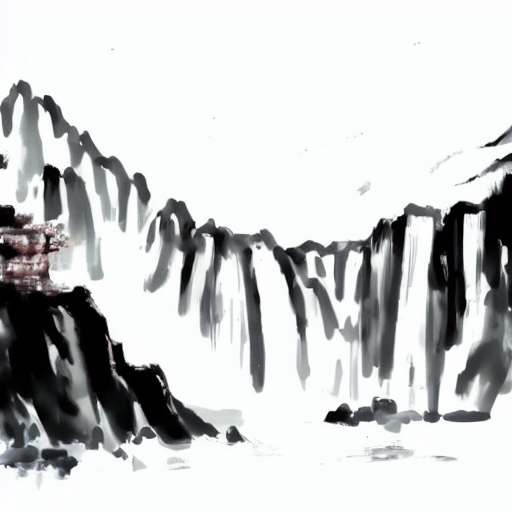

down_cross: 64 X 64


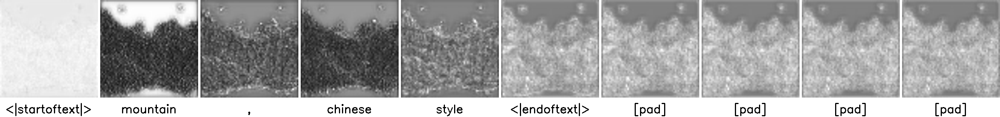

down_cross: 32 X 32


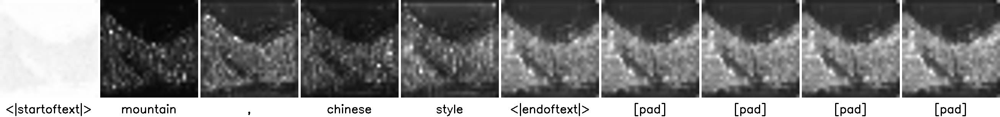

down_cross: 16 X 16


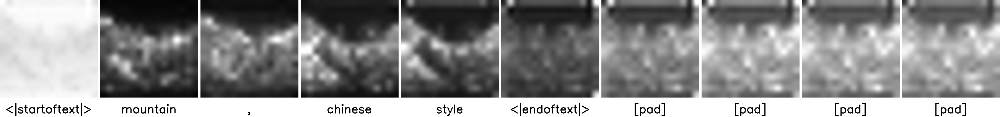

mid_cross: 8 X 8


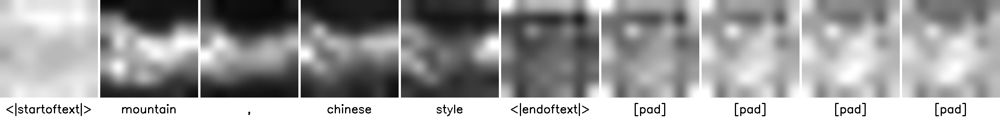

up_cross: 16 X 16


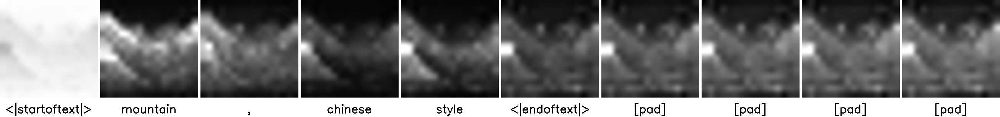

up_cross: 32 X 32


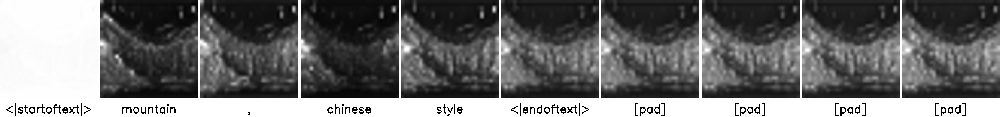

up_cross: 64 X 64


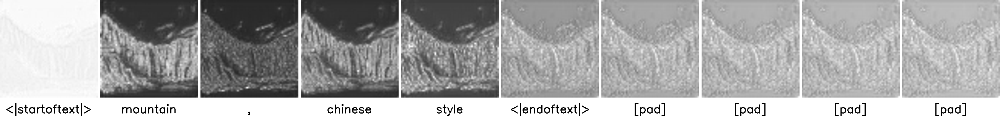

In [18]:
evaluate_inversion('/home/jiaqiguo/pnp-diffusers/data/test_1.jpg', "landscape, Chinese style", "mountain, Chinese style")

/tmp/ipykernel_802149/515839477.py:4: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (1, model.unet.in_channels, height // 8, width // 8),
/tmp/ipykernel_802149/515839477.py:7: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = latent.expand(batch_size,  model.unet.in_channels, height // 8, width // 8).to(model.device)


register down_blocks


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:03<00:00, 13.13it/s]


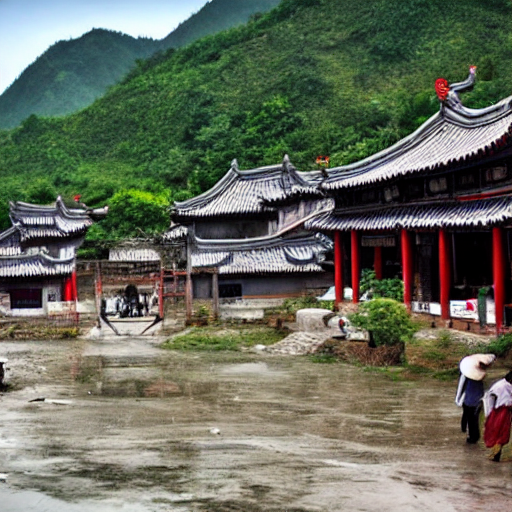

down_cross: 64 X 64


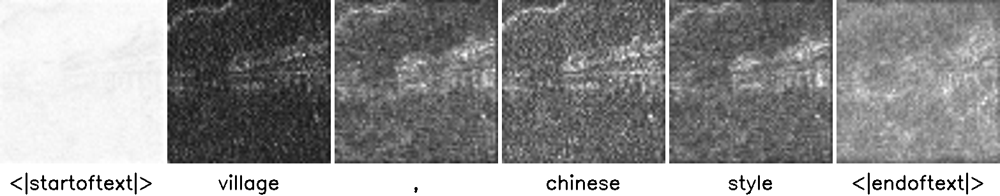

down_cross: 32 X 32


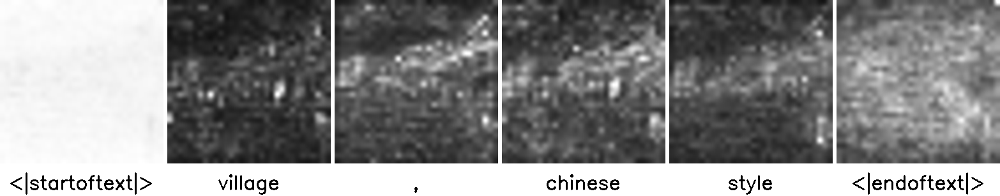

down_cross: 16 X 16


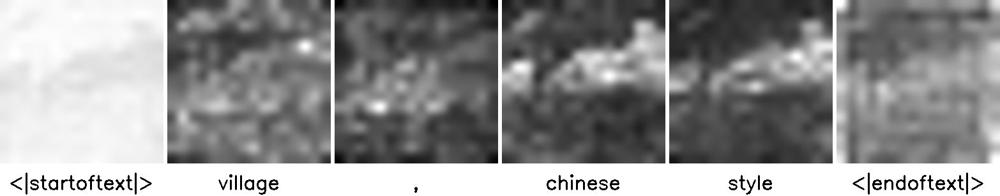

mid_cross: 8 X 8


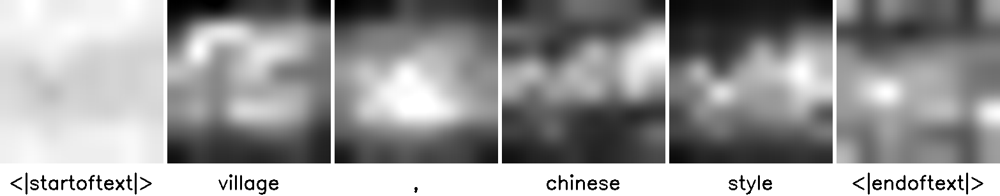

up_cross: 16 X 16


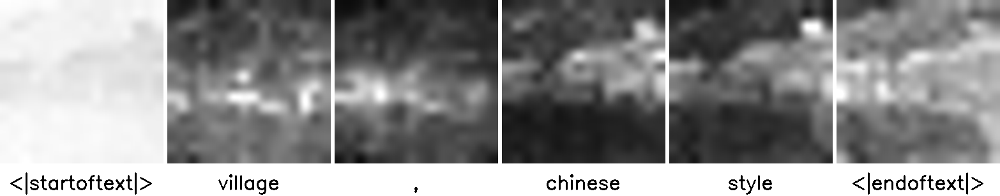

up_cross: 32 X 32


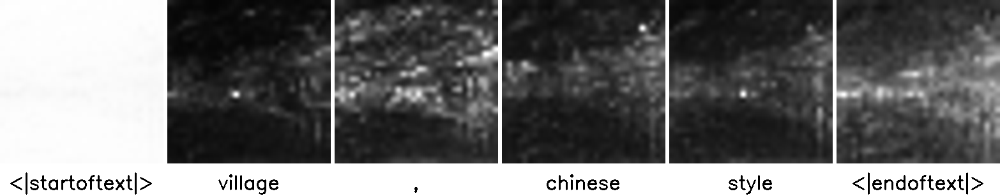

up_cross: 64 X 64


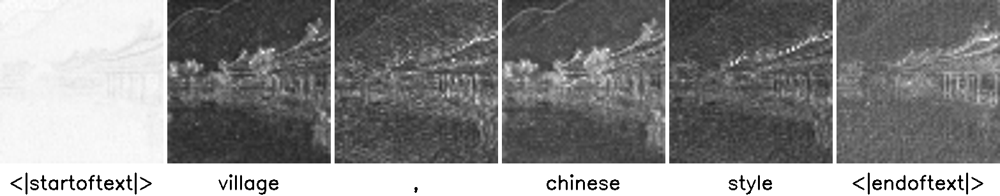

In [11]:
evaluate("village, Chinese style")

In [16]:
evaluate_inversion('/home/jiaqiguo/pnp-diffusers/data/test_1.jpg', "landscape, Chinese style", "cat, Chinese style")

RuntimeError: The size of tensor a (8) must match the size of tensor b (4) at non-singleton dimension 0

In [ ]:
evaluate_conv("monkey with a hat walking on the street", steps=[0, 5, 10, 15, 20, 25, 30, 35, 40, 45], vis_key="up_block1_res2")

In [ ]:
evaluate_conv("a oil painting of monkey with a hat walking on the street", steps=[0, 5, 10, 15, 20, 25, 30, 35, 40, 45], vis_key="up_block2_res2")

In [ ]:
evaluate_conv("a village in the style of oil painting", steps=[0, 5, 10, 15, 20, 25, 30, 35, 40, 45], vis_key="up_block2_res2")

In [ ]:
evaluate("a village in the style of oil painting")

In [ ]:
evaluate("a village in the style of oil painting")

In [ ]:
evaluate("an oil painting of a village")

In [ ]:
evaluate("an watercolor painting of a village")

In [ ]:
evaluate("a watercolor painting of a museum")

In [ ]:
evaluate("a photo of a little boy reading a book in his room")

In [ ]:
evaluate("a little boy reading a book about watercolor painting in his room")

In [ ]:
evaluate("a cat is playing with a dog in watercolor painting style")

In [ ]:
evaluate("a cat is playing with a dog in oil painting style")

In [ ]:
evaluate("a cat is playing with a dog in line drawing style")

In [ ]:
evaluate("a cat is playing with a dog in line drawing style")

In [ ]:
evaluate("a cat is sleeping in a forest, cartoon")

In [ ]:
evaluate("a warm happy birthday card with a cake and several candles")

In [ ]:
evaluate("monkey with a hat walking on the street")

In [ ]:
evaluate("a painting of an elephant with glasses")

In [ ]:
evaluate_self_attn("a painting of an elephant with glasses")

In [ ]:
evaluate_self_attn("a doll wearing a sunglasss in the style of watercolor")

In [ ]:
evaluate("a watercolor painting of village")

In [ ]:
evaluate('watercolor painting')